### MRI Brian tumor dataset

dataset link: https://www.kaggle.com/datasets/navoneel/brain-mri-images-for-brain-tumor-detection

### Import Dependencies

In [4]:
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import glob

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import confusion_matrix, accuracy_score
import cv2
import random
import math
import sys

import torch.nn as nn
import torch.nn.functional as F
from torchsummary import summary
from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings('ignore')

### Reading the images

In [6]:
tumor = []
path = './brain_tumor_dataset/yes/*.jpg'

for f in glob.iglob(path):
    img = cv2.imread(f)
    img = cv2.resize(img, (128, 128))
    b, g, r = cv2.split(img)
    img = cv2.merge([r, g, b])
    tumor.append(img)

In [7]:
healthy = []
path = './brain_tumor_dataset/no/*.jpg'

for f in glob.iglob(path):
    img = cv2.imread(f)
    img = cv2.resize(img, (128, 128))
    b, g, r = cv2.split(img)
    img = cv2.merge([r, g, b])
    healthy.append(img)

In [8]:
healthy = np.array(healthy)
tumor = np.array(tumor)
All = np.concatenate((healthy, tumor))

In [9]:
tumor.shape

(154, 128, 128, 3)

In [10]:
healthy.shape

(91, 128, 128, 3)

In [11]:
All.shape

(245, 128, 128, 3)

In [12]:
np.random.choice(10, 5, replace = False)

array([6, 1, 9, 8, 0])

### Visualizing Brian MRI Images

In [14]:
tumor[0]

array([[[3, 3, 3],
        [3, 3, 3],
        [3, 3, 3],
        ...,
        [2, 2, 2],
        [2, 2, 2],
        [2, 2, 2]],

       [[3, 3, 3],
        [3, 3, 3],
        [3, 3, 3],
        ...,
        [2, 2, 2],
        [2, 2, 2],
        [2, 2, 2]],

       [[3, 3, 3],
        [3, 3, 3],
        [3, 3, 3],
        ...,
        [2, 2, 2],
        [2, 2, 2],
        [2, 2, 2]],

       ...,

       [[2, 2, 2],
        [2, 2, 2],
        [2, 2, 2],
        ...,
        [2, 2, 2],
        [2, 2, 2],
        [3, 3, 3]],

       [[2, 2, 2],
        [2, 2, 2],
        [2, 2, 2],
        ...,
        [2, 2, 2],
        [2, 2, 2],
        [3, 3, 3]],

       [[2, 2, 2],
        [2, 2, 2],
        [2, 2, 2],
        ...,
        [1, 1, 1],
        [1, 1, 1],
        [2, 2, 2]]], dtype=uint8)

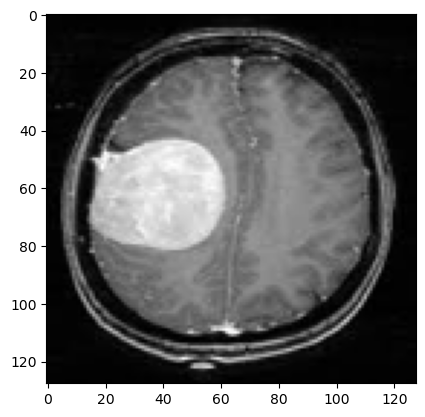

In [15]:
plt.imshow(tumor[0])

In [16]:
np.random.choice(healthy.shape[0], 5, replace = False)

array([65, 71, 47, 68, 23])

In [17]:
def plot_random(healthy, tumor, num=5):
    healthy_imgs = healthy[np.random.choice(healthy.shape[0], num, replace = False)]
    tumor_imgs = tumor[np.random.choice(tumor.shape[0], num, replace = False)]
    
    plt.figure(figsize=(16, 9))
    for i in range(num):
        plt.subplot(1, num, i+1)
        plt.title('Healthy')
        plt.imshow(healthy_imgs[i])
        
    plt.figure(figsize=(16, 9))
    for i in range(num):
        plt.subplot(1, num, i+1)
        plt.title('Tumor')
        plt.imshow(tumor[i])

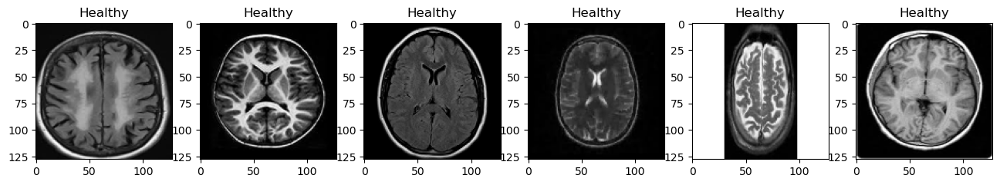

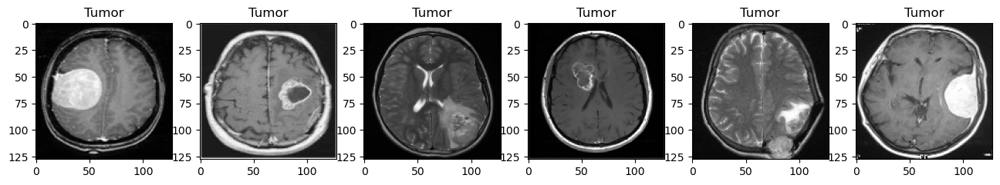

In [18]:
plot_random(healthy, tumor, 6)

### Create Torch Dataset Class

In [20]:
class Dataset(object):
    """"An abstract class representing a dataset
    
    All other datasets should subclass it. All subclasses should override
    ``__len__, that provides the size of the dataset, and ``__getitem__``,
    supporting integer indexing in range from 0 to len(self) exclusive.
    """
    
    def __getitem__(self, index):
        raise NotImplementedError
    
    def __len__(self):
        raise NotImplementedError
    
    def __add__(self, other):
        return ConcatDataset([self, other])

Example class for study purpose

In [22]:
class MRI_example(Dataset):
    def __init__(self, scores):
        self.x = scores

    def __getitem__(self, index):
        return self.x[index]

    def __len__(self):
        return len(self.x)

In [23]:
s = [1, 2, 3, 4]
d = MRI_example(s)

In [24]:
d[2]

3

In [25]:
len(d)

4

In [26]:
s1 = [4, 5, 6, 7, 9]
d1 = MRI_example(s1)

s2 = [10, 20, 30, 40, 50]
d2 = MRI_example(s2)

In [27]:
d = d1 + d2

In [28]:
len(d)

10

### Creating MRI custom dataset class

In [30]:
class MRI(Dataset):
    def __init__(self):
        
        tumor = []
        healthy = []
        
        # cv2 - It reads in BGR format by default
        for f in glob.iglob('./brain_tumor_dataset/yes/*.jpg'):
            img = cv2.imread(f)
            img = cv2.resize(img, (128, 128))
            b, g, r = cv2.split(img)
            img = cv2.merge([r, g, b])
            img = img.reshape((img.shape[2], img.shape[0], img.shape[1])) # otherwise the shape will be (h, w, c). now (c, h, w)
            tumor.append(img)        

        for f in glob.iglob('./brain_tumor_dataset/no/*.jpg'):
            img = cv2.imread(f)
            img = cv2.resize(img, (128, 128))
            b, g, r = cv2.split(img)
            img = cv2.merge([r, g, b])
            img = img.reshape((img.shape[2], img.shape[0], img.shape[1])) # otherwise the shape will be (h, w, c). now (c, h, w)
            healthy.append(img)

        # our images
        tumor = np.array(tumor, dtype=np.float32)
        healthy = np.array(healthy, dtype=np.float32)

        # our labels
        # 1 --> tumor
        # 0 --> healthy
        tumor_label = np.ones(tumor.shape[0], dtype=np.float32)
        healthy_label = np.zeros(healthy.shape[0], dtype=np.float32)

        # Concatenates        
        self.images = np.concatenate((tumor, healthy), axis = 0)
        self.labels = np.concatenate((tumor_label, healthy_label), axis = 0)

    def __getitem__(self, index):
        sample = {'image' : self.images[index], 'label' : self.labels[index]}
        return sample

    def __len__(self):
        return self.images.shape[0]

    def normalize(self):
        self.images = self.images/255.0

create object

In [32]:
mri = MRI()

In [33]:
img = mri[5]['image']

In [34]:
img.shape

(3, 128, 128)

In [35]:
np.max(img)

255.0

In [36]:
np.min(img)

12.0

Normalize the image

In [38]:
mri.normalize()

In [39]:
img = mri[5]['image']

In [40]:
np.max(img)

1.0

In [41]:
np.max(img)

1.0

### Creating a Dataloader

### without Dataloader

#### Option 1:

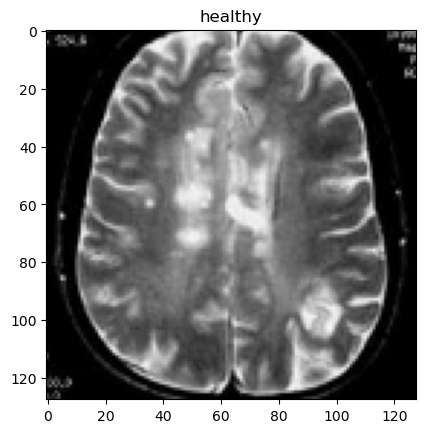

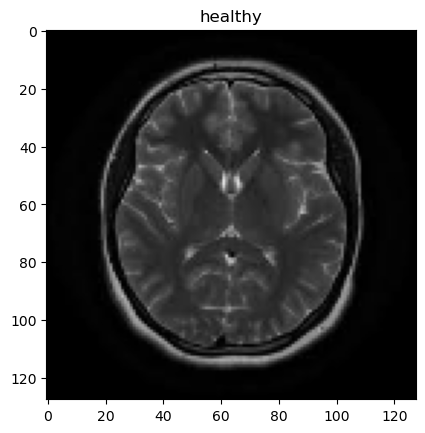

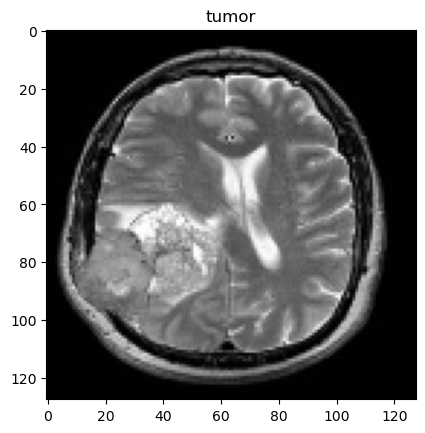

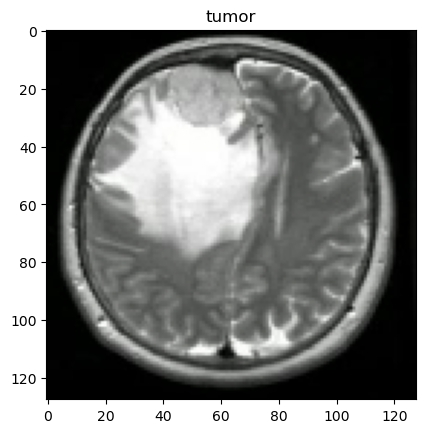

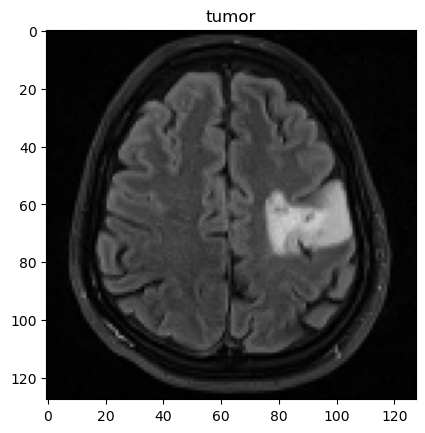

...

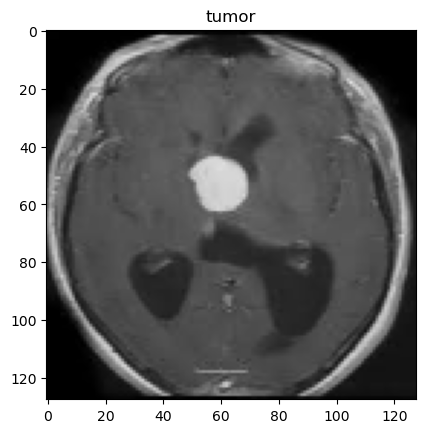

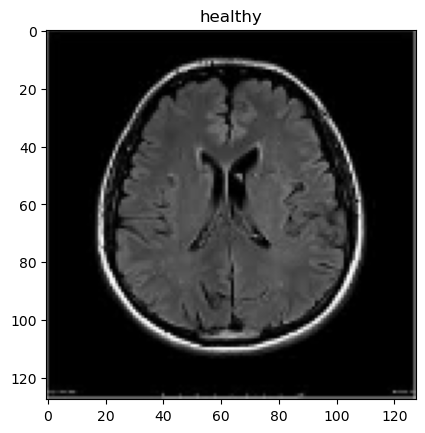

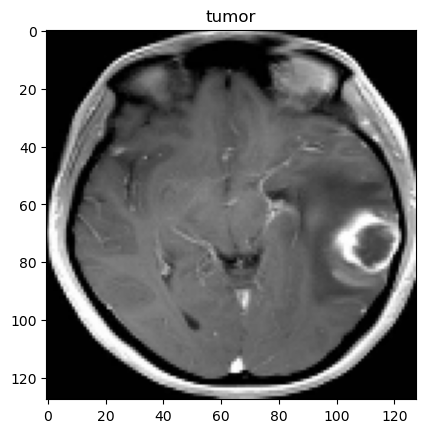

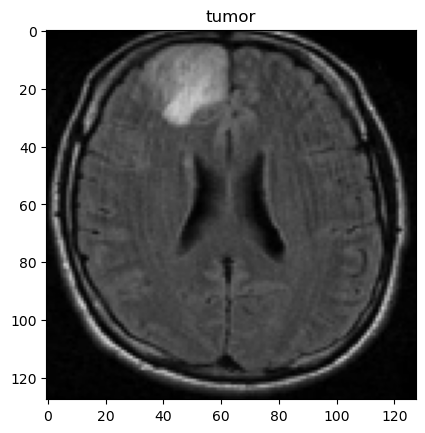

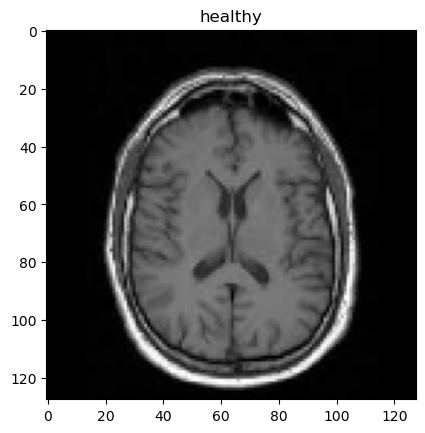

In [45]:
index = list(range(len(mri)))
random.shuffle(index)
for idx in index:
    sample = mri[idx]
    img = sample['image']
    label = sample['label']
    img = img.reshape(img.shape[1], img.shape[2], img.shape[0])  # c, h, w ==> h, w, c
    plt.title('tumor' if label == 1.0 else 'healthy')
    plt.imshow(img)
    plt.show()

#### Option 2:

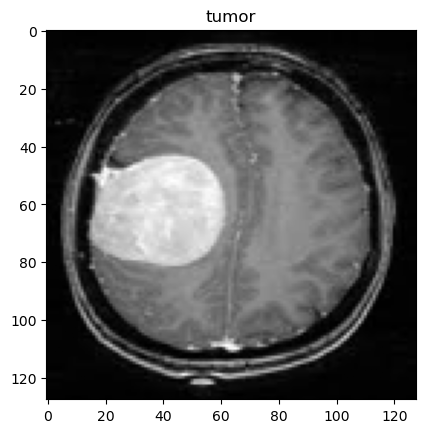

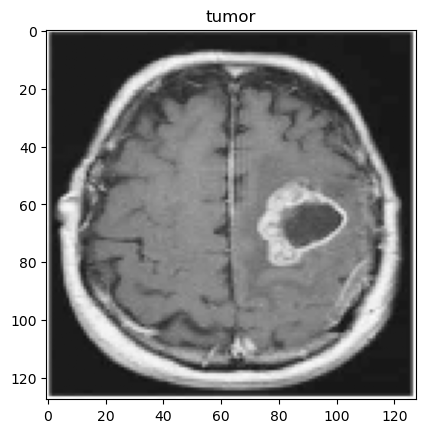

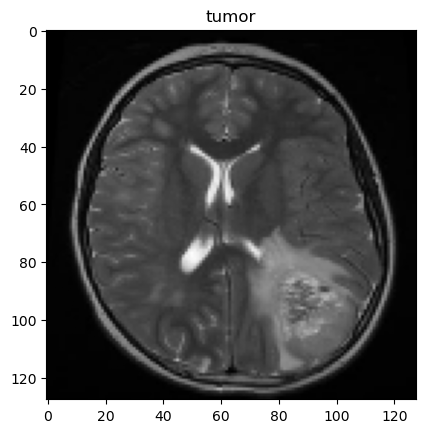

In [47]:
it = iter(mri)
for i in range(3):
    sample = next(it)
    img = sample['image']
    label = sample['label']
    img = img.reshape(img.shape[1], img.shape[2], img.shape[0])  # c, h, w ==> h, w, c
    plt.title('tumor' if label == 1.0 else 'healthy')
    plt.imshow(img)
    plt.show()

### With Dataloader

In [49]:
dataloader = DataLoader(mri, batch_size=10, shuffle=True)

In [50]:
# for sample in dataloader:
#     img = sample['image']
#     print(img.shape)
#     sys.exit()

# Output:
# torch.Size([10, 3, 128, 128])

### Create a Model

In [52]:
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.cnn_model = nn.Sequential(nn.Conv2d(in_channels=3, out_channels=6, kernel_size=5),
                                       nn.Tanh(),
                                       nn.AvgPool2d(kernel_size=2, stride=5),
                                       nn.Conv2d(in_channels=6, out_channels=16, kernel_size=5),
                                       nn.Tanh(),
                                       nn.AvgPool2d(kernel_size=2, stride=5))
        
        self.fc_model = nn.Sequential(nn.Linear(in_features=256, out_features=120),
                                      nn.Tanh(),
                                      nn.Linear(in_features=120, out_features=84),
                                      nn.Tanh(),
                                      nn.Linear(in_features=84, out_features=1))

    def forward(self, x):
        x = self.cnn_model(x)
        x = x.view(x.size(0), -1)
        x = self.fc_model(x)
        x = F.sigmoid(x)

        return x

### The logic behind the numbers

Here is the grand formnula:
<img src="./n_out formula.png" alt="formula" width="25%" />

In [54]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [55]:
model = CNN().to(device)

In [56]:
model

CNN(
  (cnn_model): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): Tanh()
    (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): Tanh()
    (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
  )
  (fc_model): Sequential(
    (0): Linear(in_features=256, out_features=120, bias=True)
    (1): Tanh()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): Tanh()
    (4): Linear(in_features=84, out_features=1, bias=True)
  )
)

In [57]:
summary(model, input_size=(3, 128, 128), device=str(device))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 6, 124, 124]             456
              Tanh-2          [-1, 6, 124, 124]               0
         AvgPool2d-3            [-1, 6, 25, 25]               0
            Conv2d-4           [-1, 16, 21, 21]           2,416
              Tanh-5           [-1, 16, 21, 21]               0
         AvgPool2d-6             [-1, 16, 4, 4]               0
            Linear-7                  [-1, 120]          30,840
              Tanh-8                  [-1, 120]               0
            Linear-9                   [-1, 84]          10,164
             Tanh-10                   [-1, 84]               0
           Linear-11                    [-1, 1]              85
Total params: 43,961
Trainable params: 43,961
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.19
Forward/ba

### CNN Model

In [59]:
model.cnn_model

Sequential(
  (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
  (1): Tanh()
  (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
  (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
  (4): Tanh()
  (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
)

In [60]:
model.cnn_model[0]

Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))

In [61]:
model.cnn_model[0].weight

Parameter containing:
tensor([[[[ 0.0673, -0.1124, -0.1074, -0.0467, -0.0367],
          [ 0.0044,  0.0974, -0.0675,  0.0318,  0.0818],
          [-0.0228, -0.0834, -0.0745, -0.1092, -0.0437],
          [-0.0405,  0.0581, -0.0966, -0.0726,  0.0559],
          [-0.0896, -0.0999, -0.1069,  0.0059,  0.1079]],

         [[-0.1101, -0.0210,  0.0301, -0.0379,  0.0083],
          [ 0.1021,  0.0593, -0.0773,  0.0390, -0.0802],
          [ 0.0190, -0.0334, -0.0736, -0.0131,  0.0635],
          [-0.0369,  0.1006, -0.0779, -0.0485,  0.0988],
          [-0.0377, -0.0427,  0.0978, -0.0765,  0.0435]],

         [[ 0.0205,  0.0983, -0.0391, -0.0557,  0.0866],
          [-0.0726, -0.0722, -0.0783, -0.0126,  0.0310],
          [-0.0610, -0.0596,  0.0518,  0.0065, -0.0128],
          [ 0.0299,  0.0047,  0.0712,  0.1010, -0.0468],
          [ 0.1034,  0.0717,  0.0444, -0.1066,  0.0369]]],


        [[[ 0.0459,  0.0147, -0.0802,  0.0474, -0.0996],
          [-0.0191,  0.0281, -0.0407,  0.0516, -0.0938],
 

In [62]:
model.cnn_model[0].weight.shape

torch.Size([6, 3, 5, 5])

In [63]:
model.cnn_model[0].weight[0].shape

torch.Size([3, 5, 5])

In [64]:
model.cnn_model[0].weight[0][0]

tensor([[ 0.0673, -0.1124, -0.1074, -0.0467, -0.0367],
        [ 0.0044,  0.0974, -0.0675,  0.0318,  0.0818],
        [-0.0228, -0.0834, -0.0745, -0.1092, -0.0437],
        [-0.0405,  0.0581, -0.0966, -0.0726,  0.0559],
        [-0.0896, -0.0999, -0.1069,  0.0059,  0.1079]], device='cuda:0',
       grad_fn=<SelectBackward0>)

### Linear layer

In [66]:
model.fc_model

Sequential(
  (0): Linear(in_features=256, out_features=120, bias=True)
  (1): Tanh()
  (2): Linear(in_features=120, out_features=84, bias=True)
  (3): Tanh()
  (4): Linear(in_features=84, out_features=1, bias=True)
)

In [67]:
model.fc_model[0]

Linear(in_features=256, out_features=120, bias=True)

In [68]:
model.fc_model[0].weight.shape

torch.Size([120, 256])

### Understanding x.view(x.size(0), -1)

In [70]:
x = torch.tensor([1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16])

In [71]:
x = x.reshape((2,2,2,2))

In [72]:
x

tensor([[[[ 1,  2],
          [ 3,  4]],

         [[ 5,  6],
          [ 7,  8]]],


        [[[ 9, 10],
          [11, 12]],

         [[13, 14],
          [15, 16]]]])

In [73]:
x.size()

torch.Size([2, 2, 2, 2])

In [74]:
x.size(0)

2

In [75]:
x.view(-1)

tensor([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16])

In [76]:
x.view(x.size(0), -1)

tensor([[ 1,  2,  3,  4,  5,  6,  7,  8],
        [ 9, 10, 11, 12, 13, 14, 15, 16]])

In [77]:
x.view(x.size(0), -1).shape

torch.Size([2, 8])

 ### torch.tensor vs torch.cuda.tensor

In [79]:
# device will be 'cuda' if a GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

# creating a CPU tensor
cpu_tensor = torch.rand(10)

# Moving same tensor to GPU
gpu_tensor = cpu_tensor.to(device)

print(cpu_tensor, cpu_tensor.dtype, type(cpu_tensor), cpu_tensor.type())
print(gpu_tensor, gpu_tensor.dtype, type(gpu_tensor), gpu_tensor.type())

# print(cpu_tensor * gpu_tensor)
# RuntimeError : expected type torch.FloatTensor but got torch.cuda.FloatTensor

cuda
tensor([0.4767, 0.0015, 0.9203, 0.3990, 0.3226, 0.5705, 0.6434, 0.5882, 0.6026,
        0.4771]) torch.float32 <class 'torch.Tensor'> torch.FloatTensor
tensor([0.4767, 0.0015, 0.9203, 0.3990, 0.3226, 0.5705, 0.6434, 0.5882, 0.6026,
        0.4771], device='cuda:0') torch.float32 <class 'torch.Tensor'> torch.cuda.FloatTensor


### Evaluate a New-Born Neural Network

In [81]:
import torch
print(torch.cuda.is_available())

True


In [82]:
mri_dataset = MRI()
mri_dataset.normalize()
device = torch.device('cuda:0') # device = torch.device('cpu')
model = CNN().to(device)

In [83]:
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=False)

In [84]:
model.eval()
outputs = []
y_true = []

with torch.no_grad():
    
    for D in dataloader:
        image = D['image'].to(device)
        label = D['label'].to(device)
    
        y_hat = model(image)
        
        outputs.append(y_hat.cpu().detach().numpy())
        y_true.append(label.cpu().detach().numpy())

In [85]:
outputs = np.concatenate(outputs, axis=0)

In [86]:
outputs.shape

(245, 1)

In [87]:
outputs[0:5]

array([[0.4946678 ],
       [0.49357018],
       [0.4924326 ],
       [0.49155176],
       [0.49449912]], dtype=float32)

In [88]:
outputs = np.concatenate(outputs, axis=0).squeeze()
y_true = np.concatenate(y_true, axis=0).squeeze()

In [89]:
outputs.shape

(245,)

In [90]:
outputs[0:20]

array([0.4946678 , 0.49357018, 0.4924326 , 0.49155176, 0.49449912,
       0.49593443, 0.49615315, 0.4937773 , 0.49628863, 0.4924915 ,
       0.4913791 , 0.49277145, 0.49464917, 0.4922752 , 0.4946    ,
       0.49536476, 0.48931998, 0.49043372, 0.49103233, 0.49169534],
      dtype=float32)

In [91]:
y_true[0:20]

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1.], dtype=float32)

### Threshold Function

In [93]:
def threshold(scores, threshold=0.50, minimum=0, maximum=1.0):
    x = np.array(list(scores))
    x[x >= threshold] = maximum
    x[x < threshold] = minimum
    return x

In [94]:
accuracy_score(y_true, threshold(outputs))

0.37142857142857144

### Visualization

### Confusion Matrix

[Text(0, 0.5, 'Tumor'), Text(0, 1.5, 'Healthy')]

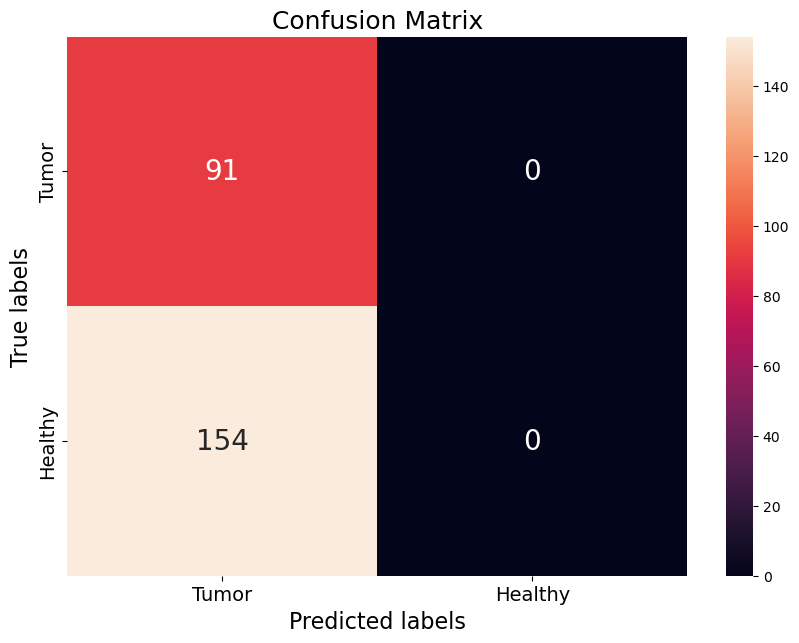

In [97]:
# a better confusion matrix

plt.figure(figsize=(10,7))
cm = confusion_matrix(y_true, threshold(outputs))
ax = plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax, annot_kws={'size':20})

# Labels, Title and Ticks
labels = ['Tumor', 'Healthy']
ax.set_xlabel('Predicted labels', fontsize=16)
ax.set_ylabel('True labels', fontsize=16)
ax.set_title('Confusion Matrix', fontsize=18)
ax.xaxis.set_ticklabels(labels, fontsize=14)
ax.yaxis.set_ticklabels(labels, fontsize=14)

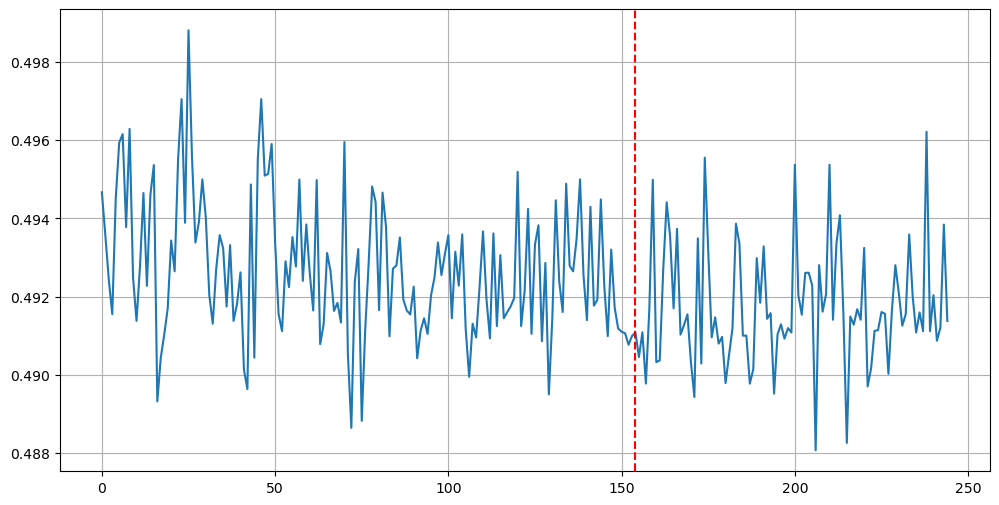

In [98]:
plt.figure(figsize=(12,6))
plt.plot(outputs)
plt.axvline(x = len(tumor), color = 'r', linestyle = '--')
plt.grid()

### Train the dumb model

In [100]:
eta = 0.0001
EPOCH = 400
optimizer = torch.optim.Adam(model.parameters(), lr=eta)
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=True)
model.train()

CNN(
  (cnn_model): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): Tanh()
    (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): Tanh()
    (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
  )
  (fc_model): Sequential(
    (0): Linear(in_features=256, out_features=120, bias=True)
    (1): Tanh()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): Tanh()
    (4): Linear(in_features=84, out_features=1, bias=True)
  )
)

In [101]:
for epoch in range(1, EPOCH):
    losses = []
    for D in dataloader:
        optimizer.zero_grad()
        data = D['image'].to(device)
        label = D['label'].to(device)
        y_hat = model(data)

        # Define loss function
        criterion = nn.BCELoss()
        loss = criterion(y_hat.squeeze(), label)
        loss.backward()
        optimizer.step()
        losses.append(loss.item())

    if (epoch+1) % 20 == 0:
        print(f'Train Epoch: {epoch+1} \tLoss: {np.mean(losses):.4f}')

Train Epoch: 20 	Loss: 0.5957
Train Epoch: 40 	Loss: 0.5226
Train Epoch: 60 	Loss: 0.5064
Train Epoch: 80 	Loss: 0.4665
Train Epoch: 100 	Loss: 0.4425
Train Epoch: 120 	Loss: 0.4150
Train Epoch: 140 	Loss: 0.3819
Train Epoch: 160 	Loss: 0.3594
Train Epoch: 180 	Loss: 0.3288
Train Epoch: 200 	Loss: 0.2803
Train Epoch: 220 	Loss: 0.2476
Train Epoch: 240 	Loss: 0.2216
Train Epoch: 260 	Loss: 0.1840
Train Epoch: 280 	Loss: 0.1476
Train Epoch: 300 	Loss: 0.1086
Train Epoch: 320 	Loss: 0.0843
Train Epoch: 340 	Loss: 0.0553
Train Epoch: 360 	Loss: 0.0363
Train Epoch: 380 	Loss: 0.0256
Train Epoch: 400 	Loss: 0.0176


### Evaluate smart model

In [103]:
model.eval()
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=False)
outputs = []
y_true = []

with torch.no_grad():  
    for D in dataloader:
        image = D['image'].to(device)
        label = D['label'].to(device)
    
        y_hat = model(image)

        outputs.append(y_hat.cpu().detach().numpy())
        y_true.append(label.cpu().detach().numpy())
        
outputs = np.concatenate(outputs, axis=0).squeeze()
y_true = np.concatenate(y_true, axis=0).squeeze()

In [104]:
accuracy_score(y_true, threshold(outputs))

1.0

[Text(0, 0.5, 'Tumor'), Text(0, 1.5, 'Healthy')]

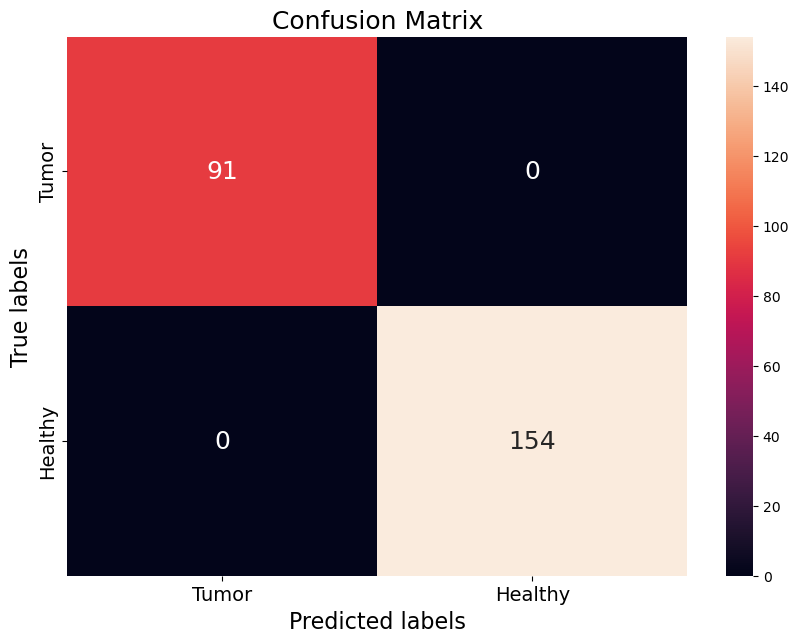

In [105]:
plt.figure(figsize=(10, 7))
cm = confusion_matrix(y_true, threshold(outputs))

ax = plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax, annot_kws={'size':18})

# Labels, Title and Ticks
labels = ['Tumor', 'Healthy']
ax.set_xlabel('Predicted labels', fontsize=16)
ax.set_ylabel('True labels', fontsize=16)
ax.set_title('Confusion Matrix', fontsize=18)
ax.xaxis.set_ticklabels(labels, fontsize=14)
ax.yaxis.set_ticklabels(labels, fontsize=14)

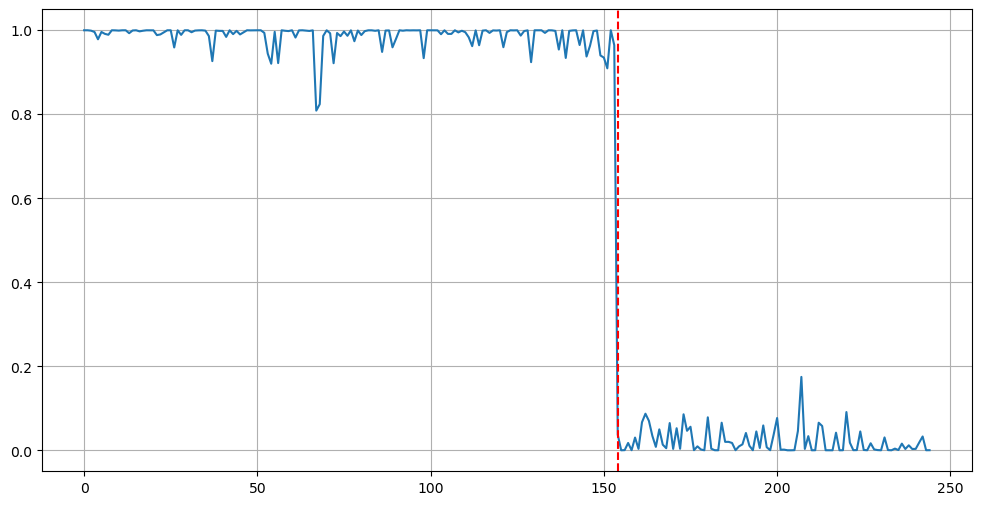

In [106]:
plt.figure(figsize=(12,6))
plt.plot(outputs)
plt.axvline(x = len(tumor), color = 'r', linestyle = '--')
plt.grid()

### Visualizing the feature maps of the convolutional filters

In [108]:
model

CNN(
  (cnn_model): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): Tanh()
    (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): Tanh()
    (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
  )
  (fc_model): Sequential(
    (0): Linear(in_features=256, out_features=120, bias=True)
    (1): Tanh()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): Tanh()
    (4): Linear(in_features=84, out_features=1, bias=True)
  )
)

In [109]:
no_of_layers = 0
conv_layers = []

In [110]:
model_children = list(model.children())
model_children

[Sequential(
   (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
   (1): Tanh()
   (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
   (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
   (4): Tanh()
   (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
 ),
 Sequential(
   (0): Linear(in_features=256, out_features=120, bias=True)
   (1): Tanh()
   (2): Linear(in_features=120, out_features=84, bias=True)
   (3): Tanh()
   (4): Linear(in_features=84, out_features=1, bias=True)
 )]

In [111]:
for child in model_children:
    if type(child) == nn.Sequential:
        for layer in child.children():
            if type(layer) == nn.Conv2d:
                no_of_layers += 1
                conv_layers.append(layer)

In [112]:
conv_layers

[Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1)),
 Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))]

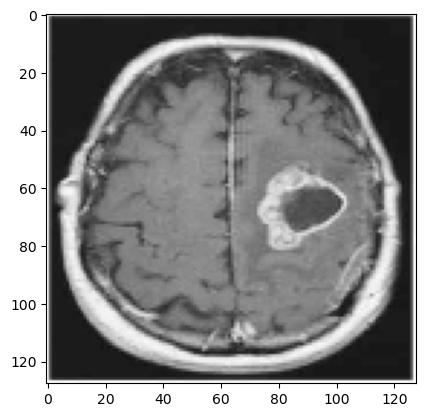

In [113]:
img = mri_dataset[100]['image']
plt.imshow(img.reshape(128, 128, 3))

In [114]:
img = torch.from_numpy(img).to(device)
img.shape

torch.Size([3, 128, 128])

In [115]:
img = img.unsqueeze(0)
img.shape

torch.Size([1, 3, 128, 128])

In [116]:
results = [conv_layers[0](img)]
for i in range(1, len(conv_layers)):
    results.append(conv_layers[i](results[-1]))
outputs = results

In [117]:
len(outputs)

2

In [118]:
outputs[0].shape

torch.Size([1, 6, 124, 124])

Layer 1 - 6 feature maps


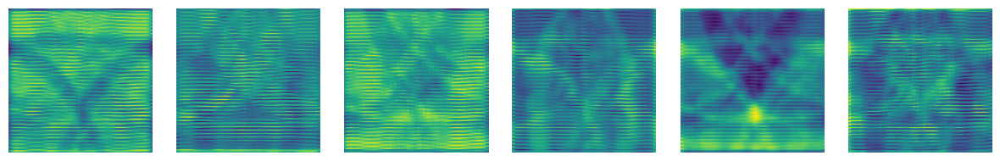

Layer 2 - 16 feature maps


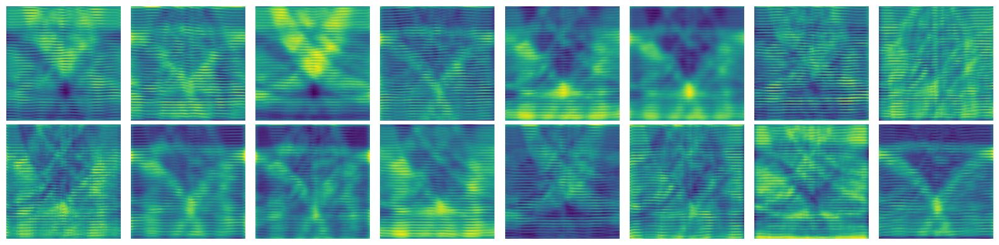

In [119]:
for num_layer, layer_output in enumerate(outputs):
    feature_maps = layer_output.squeeze()  # shape: [num_filters, H, W]
    num_filters = feature_maps.shape[0]

    cols = 8
    rows = math.ceil(num_filters / cols)

    plt.figure(figsize=(cols * 2, rows * 2))
    print(f'Layer {num_layer+1} - {num_filters} feature maps')

    for i in range(num_filters):
        plt.subplot(rows, cols, i+1)
        plt.imshow(feature_maps[i].detach().cpu().numpy())
        plt.axis('off')

    plt.tight_layout()
    plt.show()
    plt.close()

### Dataset split - train/validation

In [121]:
class MRI(Dataset):
    def __init__(self):
        # variable to hold the training data and validation data
        self.X_train, self.y_train, self.X_val, self.y_val = None, None, None, None

        # A variable to determine if we are interested in retrieving the training or validation data
        self.mode = 'train'
        
        tumor = []
        healthy = []
        
        # cv2 - It reads in BGR format by default
        for f in glob.iglob('./brain_tumor_dataset/yes/*.jpg'):
            img = cv2.imread(f)
            img = cv2.resize(img, (128, 128))
            b, g, r = cv2.split(img)
            img = cv2.merge([r, g, b])
            img = img.reshape((img.shape[2], img.shape[0], img.shape[1])) # (h, w, c) into (c, h, w)
            tumor.append(img)        

        for f in glob.iglob('./brain_tumor_dataset/no/*.jpg'):
            img = cv2.imread(f)
            img = cv2.resize(img, (128, 128))
            b, g, r = cv2.split(img)
            img = cv2.merge([r, g, b])
            img = img.reshape((img.shape[2], img.shape[0], img.shape[1])) # otherwise the shape will be (h, w, c). now (c, h, w)
            healthy.append(img)

        # our images
        tumor = np.array(tumor, dtype=np.float32)
        healthy = np.array(healthy, dtype=np.float32)

        # our labels
        # 1 --> tumor
        # 0 --> healthy
        tumor_label = np.ones(tumor.shape[0], dtype=np.float32)
        healthy_label = np.zeros(healthy.shape[0], dtype=np.float32)

        # Concatenates        
        self.images = np.concatenate((tumor, healthy), axis = 0)
        self.labels = np.concatenate((tumor_label, healthy_label), axis = 0)

    # Define a function that would seperate the data into Training and Validation sets
    def train_val_split(self):
        self.X_train, self.X_val, self.y_train, self.y_val = train_test_split(self.images, self.labels, test_size=0.20, random_state=42)

    
    def __getitem__(self, index):
        # use self.mode to determine whether train or val data is of interest
        if self.mode == 'train':
            sample = {'image' : self.X_train[index], 'label' : self.y_train[index]}
        elif self.mode == 'val':
            sample = {'image' : self.X_val[index], 'label' : self.y_val[index]}
        
        return sample

    def __len__(self):
        # use self.mode to determine whether train or val data is of interest
        if self.mode == 'train':
            return self.X_train.shape[0]
        elif self.mode == 'val':
            return self.X_val.shape[0]

    def normalize(self):
        self.images = self.images/255.0

In [122]:
mri_dataset = MRI()
mri_dataset.normalize()
mri_dataset.train_val_split()

In [123]:
train_dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=True)
val_dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=False)

In [124]:
device = torch.device('cuda:0')
model = CNN().to(device)

In [125]:
eta = 0.0001
optimizer = torch.optim.Adam(model.parameters(), lr=eta)

In [126]:
# Keep track of epoch losses
epoch_train_loss = []
epoch_val_loss = []

In [127]:
for epoch in range(1, 600):
    train_losses = []
    # train for the current epoch
    model.train()
    mri_dataset.mode == 'train'
    for D in train_dataloader:
        # train the model
        optimizer.zero_grad()
        data = D['image'].to(device)
        label = D['label'].to(device)

        y_hat = model(data)
        criterion = nn.BCELoss()
        loss = torch.sum(criterion(y_hat.squeeze(), label))
        loss.backward()
        optimizer.step()
        train_losses.append(loss.item())
        
    epoch_train_loss.append(np.mean(train_losses))
    
    # validation for the current epoch
    val_losses = []
    model.eval()
    
    mri_dataset.mode = 'val'
    with torch.no_grad():
        for D in train_dataloader:
            data = D['image'].to(device)
            label = D['label'].to(device)
            y_hat = model(data)
            criterion = nn.BCELoss()
            loss = torch.sum(criterion(y_hat.squeeze(), label))
            val_losses.append(loss.item())
            
    epoch_val_loss.append(np.mean(val_losses))

    if (epoch+1) % 20 == 0:
        print(f'Train Epoch: {epoch+1} \tTrain Loss: {np.mean(train_losses):.4f} \tVal Loss: {np.mean(val_losses):.6f}')

Train Epoch: 20 	Train Loss: 0.5677 	Val Loss: 0.586751
Train Epoch: 40 	Train Loss: 0.5739 	Val Loss: 0.594809
Train Epoch: 60 	Train Loss: 0.5449 	Val Loss: 0.566839
Train Epoch: 80 	Train Loss: 0.5525 	Val Loss: 0.552246
Train Epoch: 100 	Train Loss: 0.5344 	Val Loss: 0.504628
Train Epoch: 120 	Train Loss: 0.4901 	Val Loss: 0.497398
Train Epoch: 140 	Train Loss: 0.4465 	Val Loss: 0.475906
Train Epoch: 160 	Train Loss: 0.4122 	Val Loss: 0.426096
Train Epoch: 180 	Train Loss: 0.3393 	Val Loss: 0.319501
Train Epoch: 200 	Train Loss: 0.2651 	Val Loss: 0.294192
Train Epoch: 220 	Train Loss: 0.2023 	Val Loss: 0.214994
Train Epoch: 240 	Train Loss: 0.1482 	Val Loss: 0.145717
Train Epoch: 260 	Train Loss: 0.1119 	Val Loss: 0.098996
Train Epoch: 280 	Train Loss: 0.0698 	Val Loss: 0.076247
Train Epoch: 300 	Train Loss: 0.0574 	Val Loss: 0.047260
Train Epoch: 320 	Train Loss: 0.0390 	Val Loss: 0.035626
Train Epoch: 340 	Train Loss: 0.0261 	Val Loss: 0.025319
Train Epoch: 360 	Train Loss: 0.018

Text(0, 0.5, 'Loss')

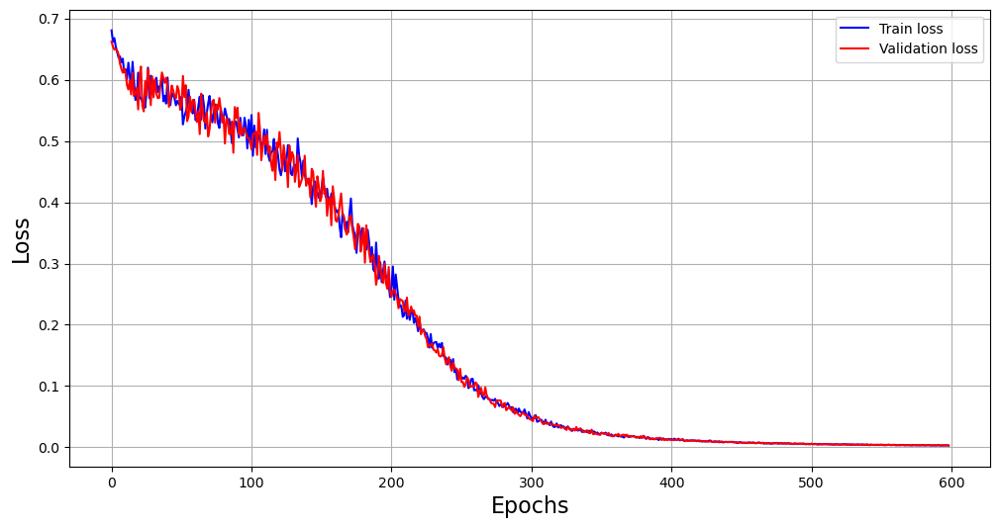

In [128]:
plt.figure(figsize=(12,6))
plt.plot(epoch_train_loss, c='b', label = 'Train loss')
plt.plot(epoch_val_loss, c='r', label = 'Validation loss')
plt.legend()
plt.grid()
plt.xlabel('Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)